<a href="https://colab.research.google.com/github/Yashvishe13/Deep-Learning/blob/main/creativeAI_video.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random 
import os
import PIL.Image
import cv2
import random
from PIL import Image

In [ ]:
tf.__version__

'2.5.0'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Load trained inceptionNet model
base_model = tf.keras.applications.InceptionV3(include_top = False, weights = 'imagenet')

87916544/87910968 [==============================] - 2s 0us/step


In [ ]:
# Open the first image
# Source: https://www.pxfuel.com/en/free-photo-xxgfs
img_1 = Image.open("/content/drive/My Drive/ColabAI/CreativeAI/fict-world.jpg")

# Open the second image
# Source: https://commons.wikimedia.org/wiki/File:Georges_Garen_embrasement_tour_Eiffel.jpg
img_2 = Image.open('/content/drive/My Drive/ColabAI/CreativeAI/night.jpg')

# Blend the two images

image = Image.blend(img_1, img_2, 0.5) # alpha --> The interpolation alpha factor. If alpha is 0.0, a copy of the first image is returned.
# If alpha is 1.0, a copy of the second image is returned. 

# Save the blended image
image.save("img_0.jpg")

In [ ]:
# Load the image
Sample_Image = tf.keras.preprocessing.image.load_img('img_0.jpg')

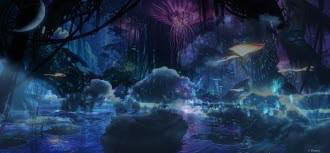

In [ ]:
Sample_Image

In [ ]:
# Get the shape of the image
np.shape(Sample_Image)

(153, 330, 3)

In [ ]:
# Check out the type of the image
type(Sample_Image)

PIL.JpegImagePlugin.JpegImageFile

In [ ]:
# Convert to numpy array
Sample_Image = tf.keras.preprocessing.image.img_to_array(Sample_Image)

In [ ]:
# Confirm that the image is converted to Numpy array
type(Sample_Image)

numpy.ndarray

In [ ]:
# Obtain the max and min values
print('min pixel values = {}, max pixel values = {}'.format(Sample_Image.min(), Sample_Image.max()))

min pixel values = 0.0, max pixel values = 255.0


In [ ]:
# Normalize the input image
Sample_Image = np.array(Sample_Image)/255.0
Sample_Image.shape

(153, 330, 3)

In [ ]:
# Let's verify normalized images values!
print('min pixel values = {}, max pixel values = {}'.format(Sample_Image.min(), Sample_Image.max()))

min pixel values = 0.0, max pixel values = 1.0


In [ ]:
Sample_Image = tf.expand_dims(Sample_Image, axis = 0)

In [ ]:
np.shape(Sample_Image)

TensorShape([1, 153, 330, 3])

In [ ]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
_______________________________________________________________________________________

In [ ]:
# Maximize the activations of these layers

names = ['mixed3', 'mixed5', 'mixed7']

# names = ['mixed3']

layers = [base_model.get_layer(name).output for name in names]

# Create the feature extraction model
deepdream_model = tf.keras.Model(inputs = base_model.input, outputs = layers)

In [ ]:
deepdream_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [ ]:
# Let's run the model by feeding in our input image and taking a look at the activations "Neuron outputs"
activations = deepdream_model(Sample_Image)
activations

[<tf.Tensor: shape=(1, 7, 18, 768), dtype=float32, numpy=
 array([[[[1.1263778 , 0.        , 0.        , ..., 1.0540124 ,
           1.0696886 , 1.5300179 ],
          [0.5300015 , 0.86058414, 0.69168353, ..., 0.46666712,
           0.2638141 , 2.2281597 ],
          [0.02763527, 2.312439  , 0.        , ..., 0.617244  ,
           1.807041  , 2.1826258 ],
          ...,
          [0.07532051, 0.01346279, 0.0773984 , ..., 0.24746275,
           1.1713091 , 0.12142643],
          [1.1280557 , 0.        , 0.6214805 , ..., 0.8227179 ,
           2.160511  , 2.3735838 ],
          [2.3529654 , 0.        , 0.03364789, ..., 1.0160953 ,
           2.160511  , 2.3735838 ]],
 
         [[0.        , 1.4372071 , 0.        , ..., 1.0540124 ,
           0.        , 0.        ],
          [0.70583296, 0.685176  , 0.        , ..., 0.46666712,
           0.41766974, 1.2315816 ],
          [1.6989062 , 0.50741565, 0.        , ..., 1.0280659 ,
           1.807041  , 1.2315816 ],
          ...,
         

In [ ]:
len(activations)

3

In [ ]:
# Since the cal_closs function includes expand dimension, let's squeeze the image (reduce_dims)
Sample_Image.shape

TensorShape([1, 153, 330, 3])

In [ ]:
Sample_Image = tf.squeeze(Sample_Image, axis = 0)

In [ ]:
Sample_Image.shape

TensorShape([153, 330, 3])

In [ ]:
def calc_loss(image, model):
# Function used for loss calculations
# It works by feedforwarding the input image through the network and generate activations
# Then obtain the average and sum of those outputs

  img_batch = tf.expand_dims(image, axis=0) # Convert into batch format
  layer_activations = model(img_batch) # Run the model
  print('ACTIVATION VALUES (LAYER OUTPUT) =\n', layer_activations)
  # print('ACTIVATION SHAPE =\n', np.shape(layer_activations))

  losses = [] # accumulator to hold all the losses
  for act in layer_activations:
    loss = tf.math.reduce_mean(act) # calculate mean of each activation 
    losses.append(loss)
  
  print('LOSSES (FROM MULTIPLE ACTIVATION LAYERS) = ', losses)
  print('LOSSES SHAPE (FROM MULTIPLE ACTIVATION LAYERS) = ', np.shape(losses))
  print('SUM OF ALL LOSSES (FROM ALL SELECTED LAYERS)= ', tf.reduce_sum(losses))

  return  tf.reduce_sum(losses) # Calculate sum 

In [ ]:
loss = calc_loss(tf.Variable(Sample_Image), deepdream_model)

ACTIVATION VALUES (LAYER OUTPUT) =
 [<tf.Tensor: shape=(1, 7, 18, 768), dtype=float32, numpy=
array([[[[1.1263778 , 0.        , 0.        , ..., 1.0540124 ,
          1.0696886 , 1.5300179 ],
         [0.5300015 , 0.86058414, 0.69168353, ..., 0.46666712,
          0.2638141 , 2.2281597 ],
         [0.02763527, 2.312439  , 0.        , ..., 0.617244  ,
          1.807041  , 2.1826258 ],
         ...,
         [0.07532051, 0.01346279, 0.0773984 , ..., 0.24746275,
          1.1713091 , 0.12142643],
         [1.1280557 , 0.        , 0.6214805 , ..., 0.8227179 ,
          2.160511  , 2.3735838 ],
         [2.3529654 , 0.        , 0.03364789, ..., 1.0160953 ,
          2.160511  , 2.3735838 ]],

        [[0.        , 1.4372071 , 0.        , ..., 1.0540124 ,
          0.        , 0.        ],
         [0.70583296, 0.685176  , 0.        , ..., 0.46666712,
          0.41766974, 1.2315816 ],
         [1.6989062 , 0.50741565, 0.        , ..., 1.0280659 ,
          1.807041  , 1.2315816 ],
        

In [ ]:
loss # Sum up the losses from both activations

<tf.Tensor: shape=(), dtype=float32, numpy=0.7077732>

In [ ]:
@tf.function
def deepdream(model, image, step_size):
    with tf.GradientTape() as tape:
      # This needs gradients relative to `img`
      # `GradientTape` only watches `tf.Variable`s by default
      tape.watch(image)
      loss = calc_loss(image, model) # call the function that calculate the loss 

    # Calculate the gradient of the loss with respect to the pixels of the input image.
    # The syntax is as follows: dy_dx = g.gradient(y, x) 
    gradients = tape.gradient(loss, image)

    print('GRADIENTS =\n', gradients)
    print('GRADIENTS SHAPE =\n', np.shape(gradients))

    # tf.math.reduce_std computes the standard deviation of elements across dimensions of a tensor
    gradients /= tf.math.reduce_std(gradients)  

    # In gradient ascent, the "loss" is maximized so that the input image increasingly "excites" the layers.
    # You can update the image by directly adding the gradients (because they're the same shape!)
    image = image + gradients * step_size
    image = tf.clip_by_value(image, -1, 1)

    return loss, image

In [ ]:
def run_deep_dream_simple(model, image, steps = 100, step_size = 0.01):
  # Convert from uint8 to the range expected by the model.
  image = tf.keras.applications.inception_v3.preprocess_input(image)

  for step in range(steps):
    loss, image = deepdream(model, image, step_size)
    
    if step % 100 == 0:
      plt.figure(figsize=(12,12))
      plt.imshow(deprocess(image))
      plt.show()
      print ("Step {}, loss {}".format(step, loss))

  # clear_output(wait=True)
  plt.figure(figsize=(12,12))
  plt.imshow(deprocess(image))
  plt.show()

  return deprocess(image)

In [ ]:
def deprocess(image):
  image = 255*(image + 1.0)/2.0
  return tf.cast(image, tf.uint8)


In [ ]:
Sample_Image.shape

TensorShape([153, 330, 3])

ACTIVATION VALUES (LAYER OUTPUT) =
 [<tf.Tensor 'model/mixed3/concat:0' shape=(1, 7, 18, 768) dtype=float32>, <tf.Tensor 'model/mixed5/concat:0' shape=(1, 7, 18, 768) dtype=float32>, <tf.Tensor 'model/mixed7/concat:0' shape=(1, 7, 18, 768) dtype=float32>]
LOSSES (FROM MULTIPLE ACTIVATION LAYERS) =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>]
LOSSES SHAPE (FROM MULTIPLE ACTIVATION LAYERS) =  (3,)
SUM OF ALL LOSSES (FROM ALL SELECTED LAYERS)=  Tensor("Sum:0", shape=(), dtype=float32)
GRADIENTS =
 Tensor("gradient_tape/Reshape_4:0", shape=(153, 330, 3), dtype=float32)
GRADIENTS SHAPE =
 (153, 330, 3)


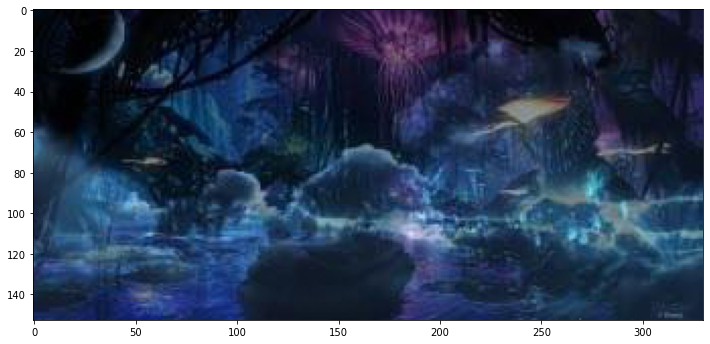

Step 0, loss 0.7691490054130554


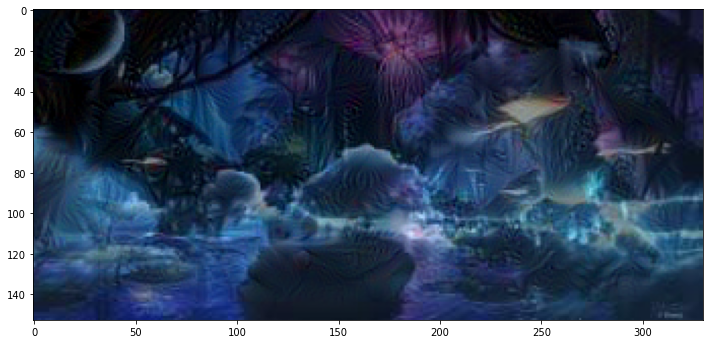

Step 100, loss 1.6081249713897705


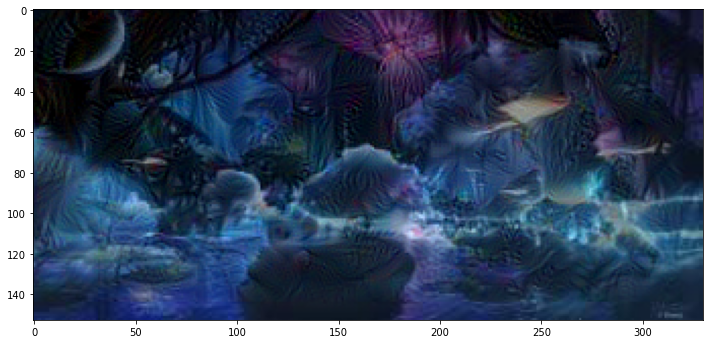

Step 200, loss 1.8281617164611816


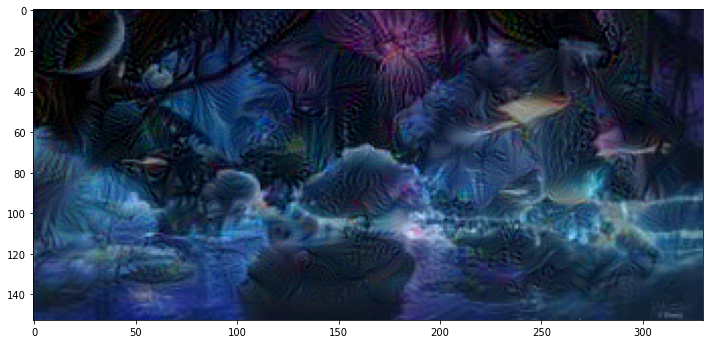

Step 300, loss 1.9562997817993164


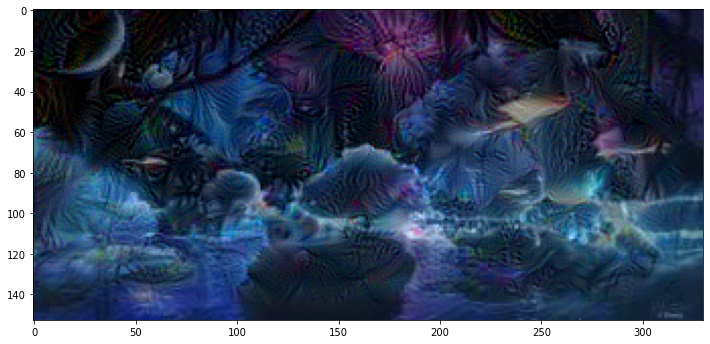

Step 400, loss 2.0494840145111084


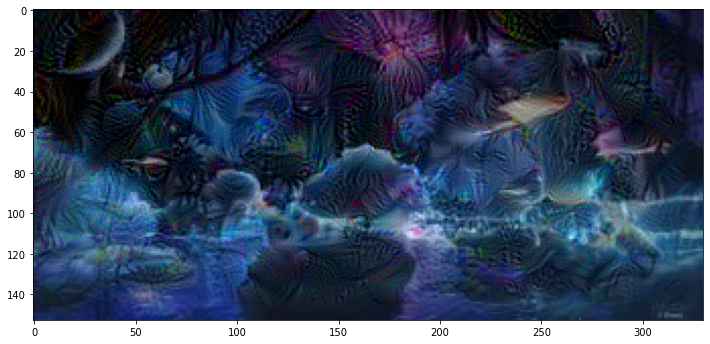

Step 500, loss 2.1229000091552734


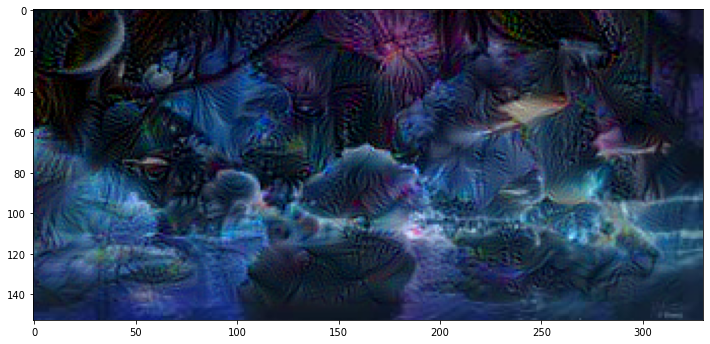

Step 600, loss 2.1827316284179688


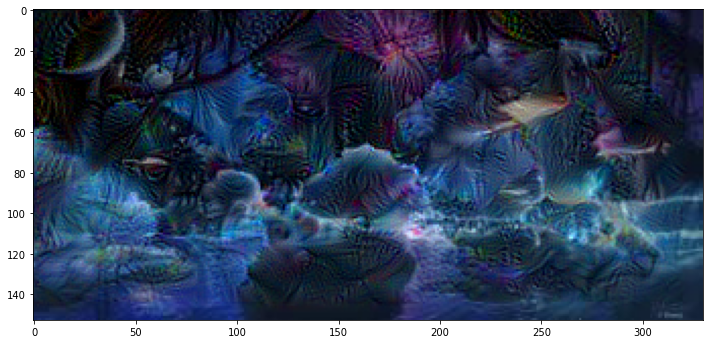

Step 700, loss 2.233262538909912


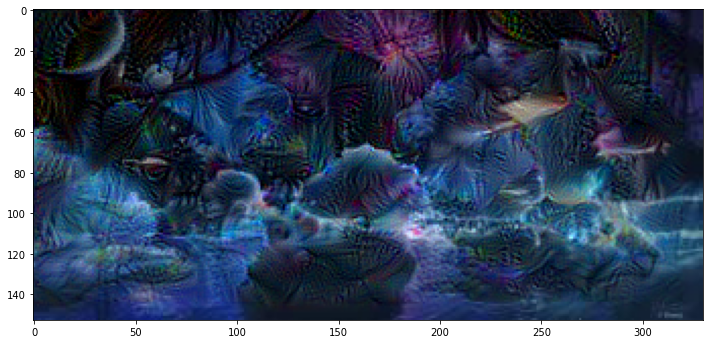

Step 800, loss 2.277494192123413


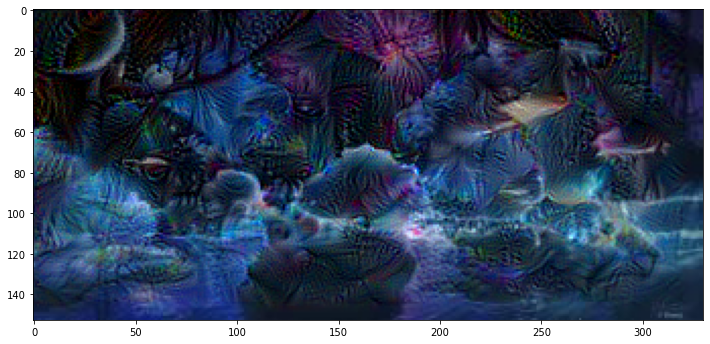

Step 900, loss 2.3157219886779785


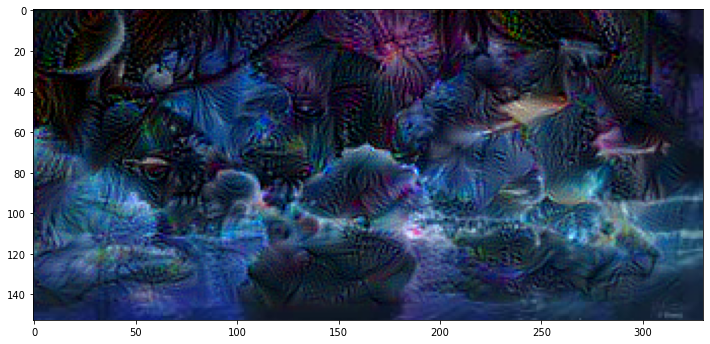

Step 1000, loss 2.3501200675964355


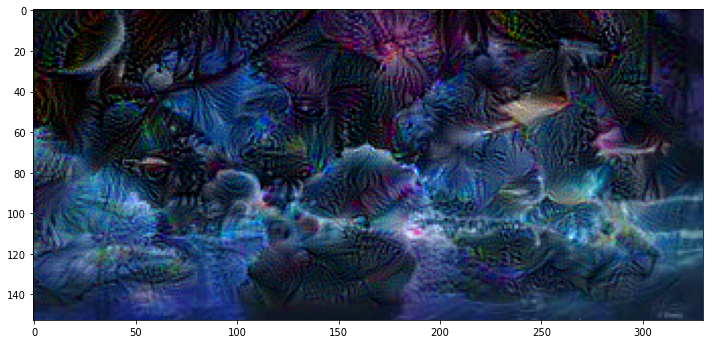

Step 1100, loss 2.380441665649414


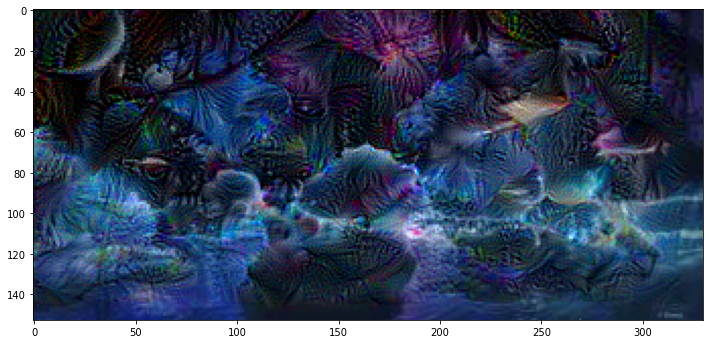

Step 1200, loss 2.408017635345459


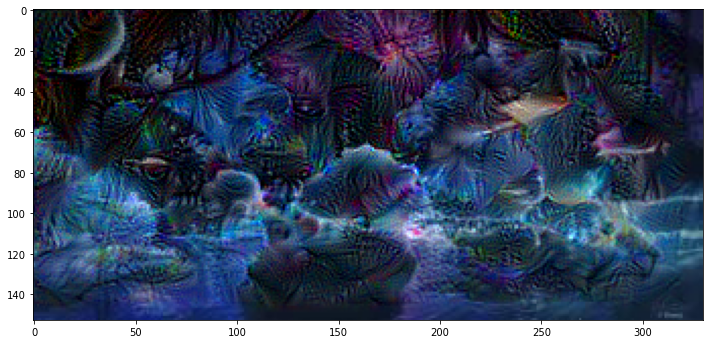

Step 1300, loss 2.432666540145874


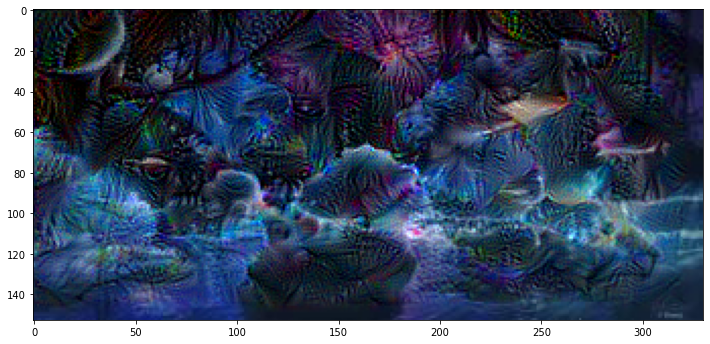

Step 1400, loss 2.456223487854004


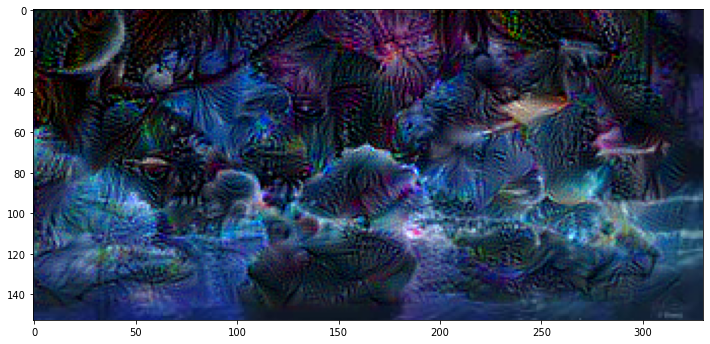

Step 1500, loss 2.4779186248779297


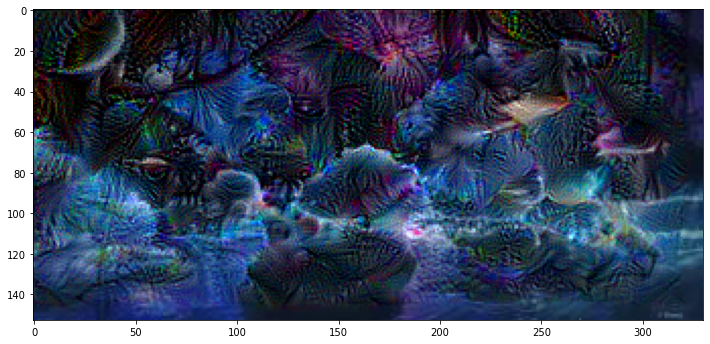

Step 1600, loss 2.4996707439422607


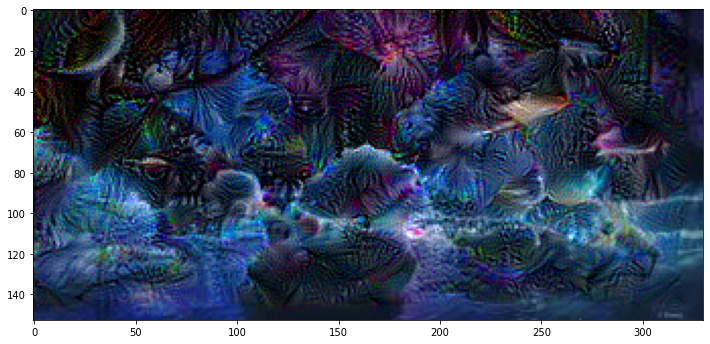

Step 1700, loss 2.520597457885742


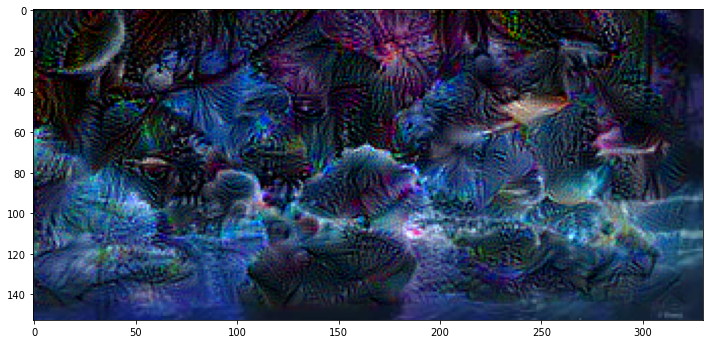

Step 1800, loss 2.5405032634735107


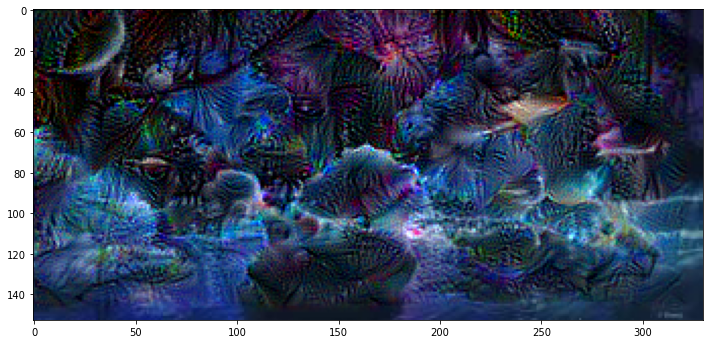

Step 1900, loss 2.5593276023864746


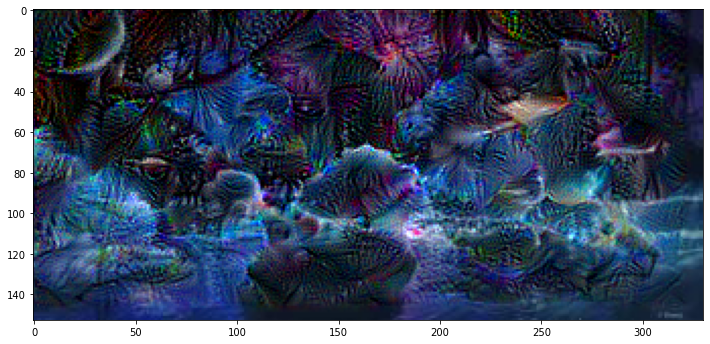

Step 2000, loss 2.577000617980957


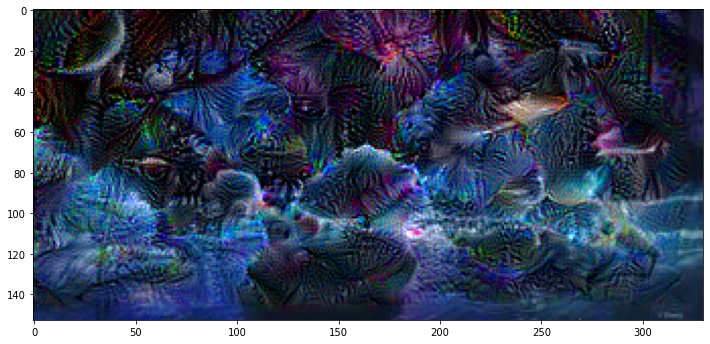

Step 2100, loss 2.5938594341278076


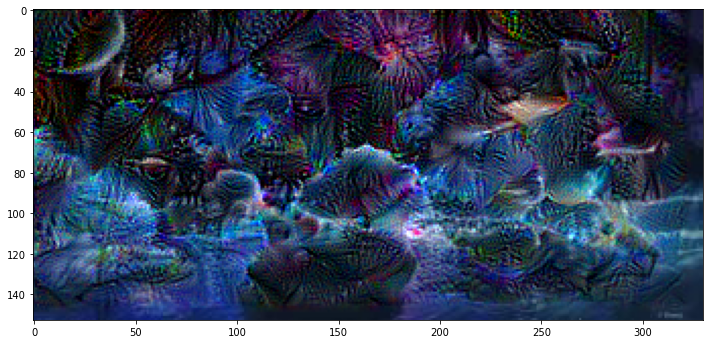

Step 2200, loss 2.6103570461273193


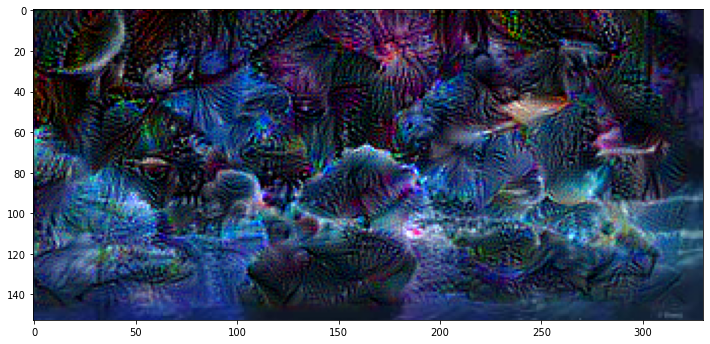

Step 2300, loss 2.6257123947143555


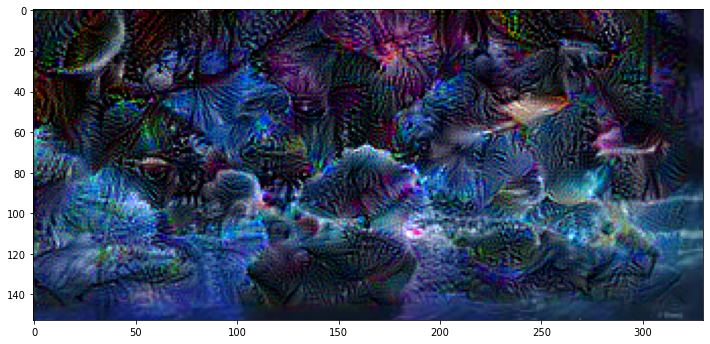

Step 2400, loss 2.6411080360412598


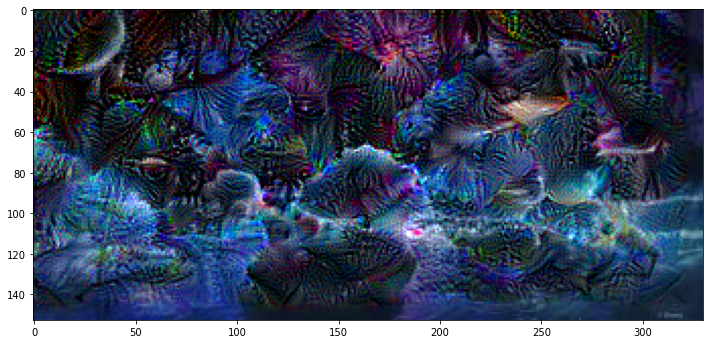

Step 2500, loss 2.6563174724578857


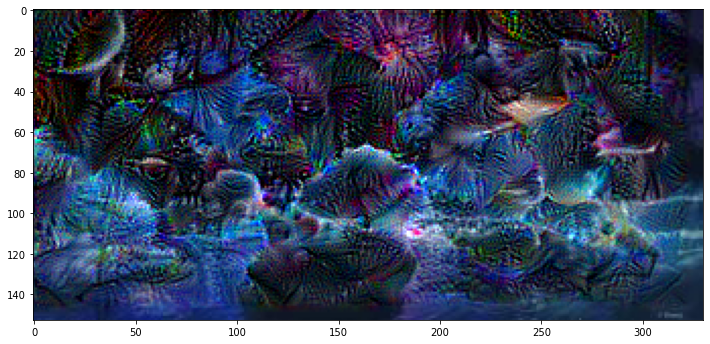

Step 2600, loss 2.6709201335906982


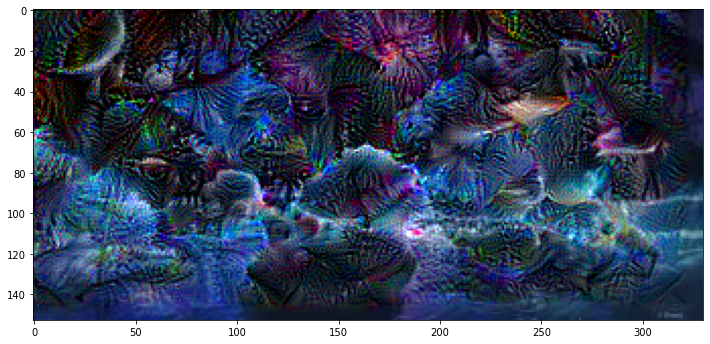

Step 2700, loss 2.6856861114501953


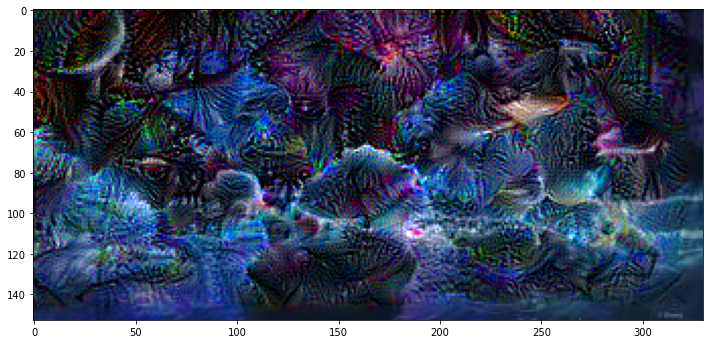

Step 2800, loss 2.699793577194214


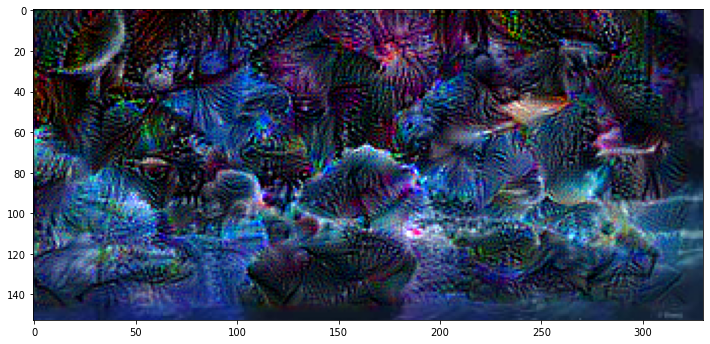

Step 2900, loss 2.713850498199463


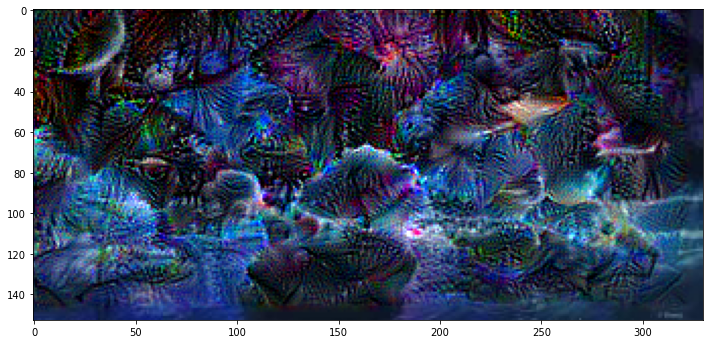

Step 3000, loss 2.7278599739074707


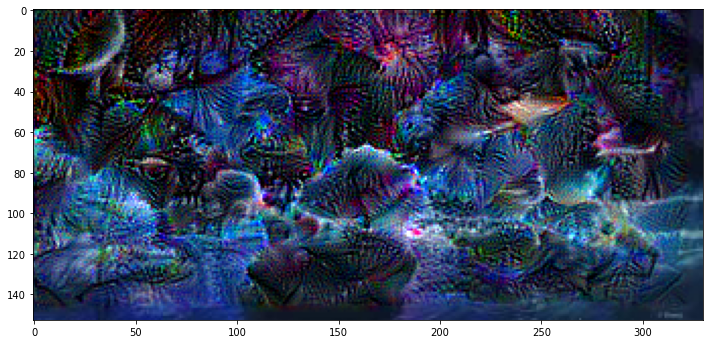

Step 3100, loss 2.7421069145202637


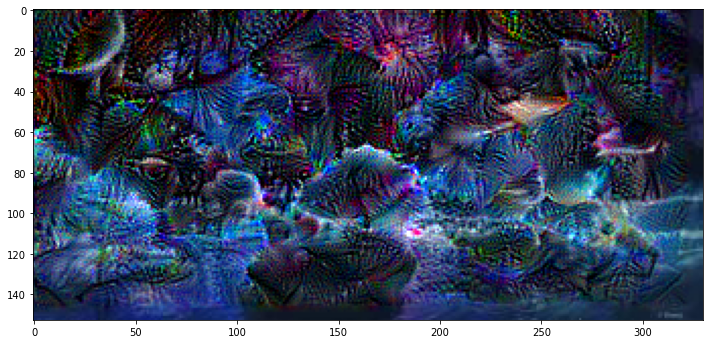

Step 3200, loss 2.7553231716156006


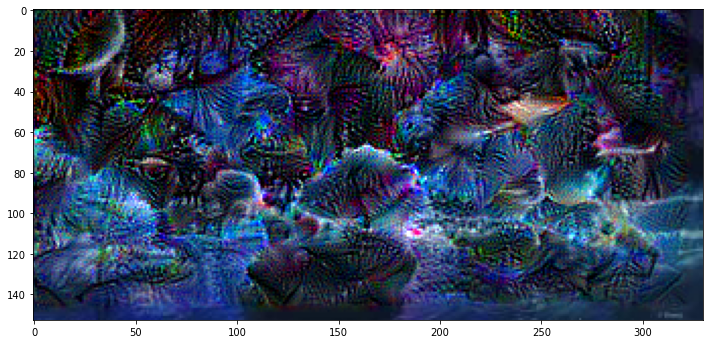

Step 3300, loss 2.7681775093078613


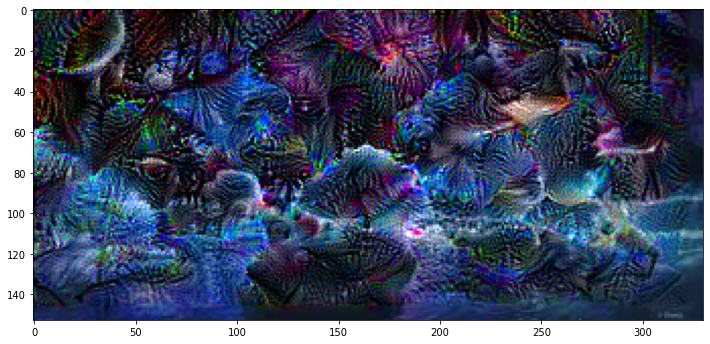

Step 3400, loss 2.7809438705444336


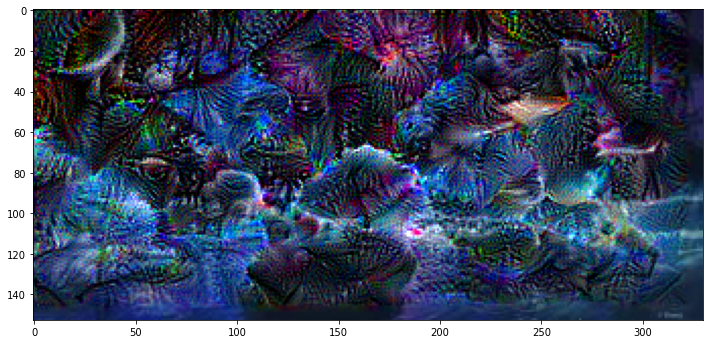

Step 3500, loss 2.7930898666381836


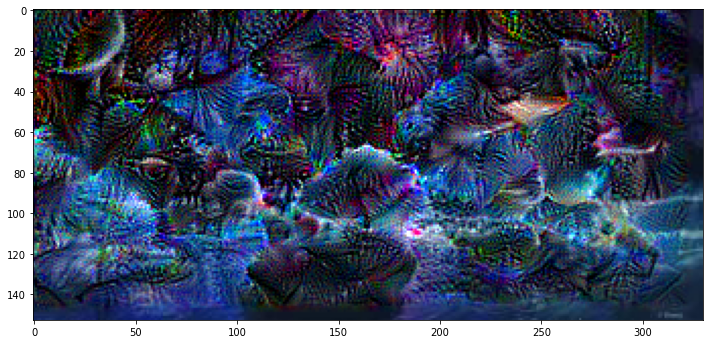

Step 3600, loss 2.805631399154663


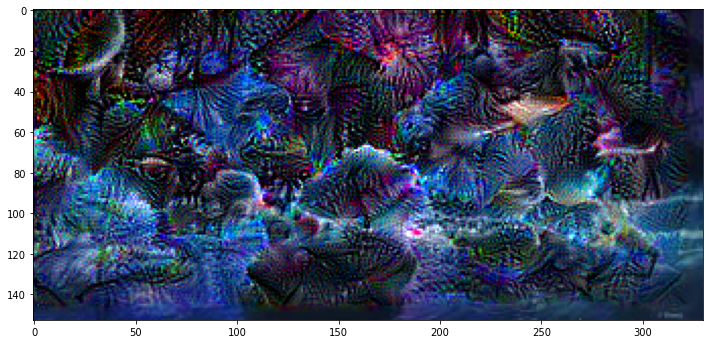

Step 3700, loss 2.8181285858154297


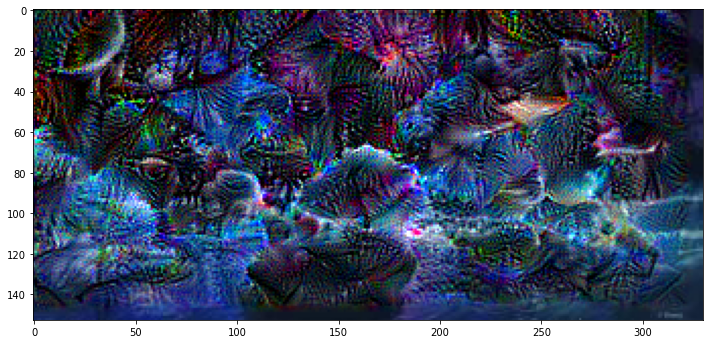

Step 3800, loss 2.831005573272705


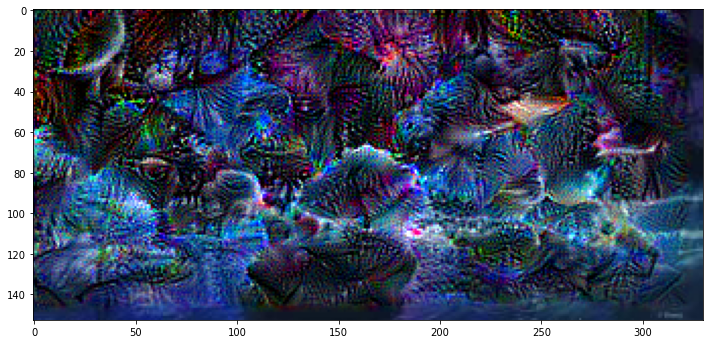

Step 3900, loss 2.843489646911621


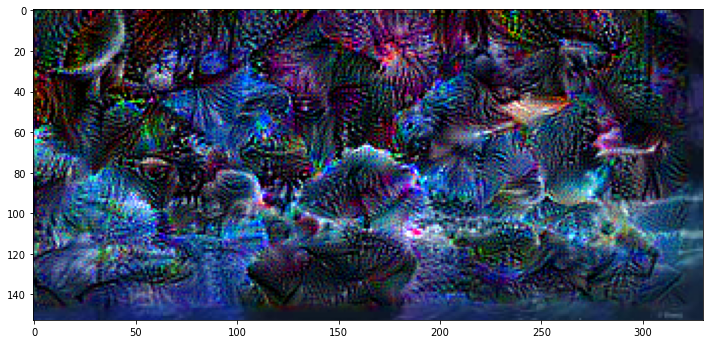

In [ ]:
# Let's Load the image again and convert it to Numpy array 
Sample_Image = np.array(tf.keras.preprocessing.image.load_img('img_0.jpg'))
dream_img = run_deep_dream_simple(model = deepdream_model, image = Sample_Image, steps = 4000, step_size = 0.001)

In [ ]:
image = tf.keras.preprocessing.image.load_img("img_0.jpg")

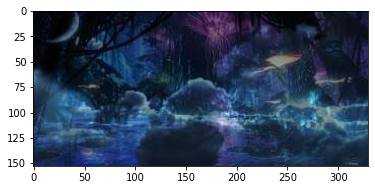

In [ ]:
plt.imshow(image)

In [ ]:
# Name of the folder
dream_name = 'fantasy'

In [ ]:
# Blended image dimension

x_size = 330  
y_size = 153

In [ ]:
# Define Counters 
created_count = 0
max_count = 100

In [ ]:
# This helper function loads an image and returns it as a numpy array of floating points

def load_image(filename):
    image = PIL.Image.open(filename)
    return np.float32(image)

In [ ]:
for i in range(0, 100):
    # Make sure to create a new folder entitled 'mars_eiffel' and place img_0 in it
    # Get into the dream directory and look for the number of images and then figure out what is the latest image. Hence this 
    # image we are going to start with and let it dream on and on
     
    if os.path.isfile('/content/drive/My Drive/ColabAI/CreativeAI/{}/img_{}.jpg'.format(dream_name, i+1)):
        print("{} present already, continue fetching the frames...".format(i+1))
        
    else:
        # Call the load image funtion
        img_result = load_image(r'/content/drive/My Drive/ColabAI/CreativeAI/{}/img_{}.jpg'.format(dream_name, i))

    
        # Zoom the image 
        x_zoom = 2 # this indicates how quick the zoom is 
        y_zoom = 1
        
        # Chop off the edges of the image and resize the image back to the original shape. This gives the visual changes of a zoom
        img_result = img_result[0+x_zoom : y_size-y_zoom, 0+y_zoom : x_size-x_zoom]
        img_result = cv2.resize(img_result, (x_size, y_size))
        
        # Adjust the RGB value of the image
        img_result[:, :, 0] += 2  # red
        img_result[:, :, 1] += 2  # green
        img_result[:, :, 2] += 2  # blue
        
        # Deep dream model  
        img_result = run_deep_dream_simple(model = deepdream_model, image = img_result, steps = 500, step_size = 0.001)
        
        # Clip the image, convert the datatype of the array, and then convert to an actual image. 
        img_result = np.clip(img_result, 0.0, 255.0)
        img_result = img_result.astype(np.uint8)
        result = PIL.Image.fromarray(img_result, mode='RGB')
        
        # Save all the frames in the dream location
        result.save(r'/content/drive/My Drive/ColabAI/CreativeAI/{}/img_{}.jpg'.format(dream_name, i+1))
        
        created_count += 1
        if created_count > max_count:
            break

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving fantasy.zip to fantasy.zip


In [ ]:
from zipfile import ZipFile
file_name = "fantasy.zip"

with ZipFile(file_name, 'r') as zip:
  zip.extractall()
  print('Done')

Done


In [ ]:
# Path of all the frames

dream_path = 'fantasy'

In [ ]:
# Define the codec and create VideoWriter object 
# Download FFmeg 

fourcc = cv2.VideoWriter_fourcc(*'XVID') # FourCC is a 4-byte code used to specify the video codec

out = cv2.VideoWriter('deepdreamvideo.avi', fourcc , 20.0, (330, 153)) # Specify the fourCC, frames per second (fps),
                                                                            # and frame size
# The frames per second value is depends on few important things
# 1. The number of frames we have created. Less number of frames brings small fps
# 2. The larger the image the bigger the fps value. For example, 1080 pixel image can bring 60 fps 

In [ ]:
for i in range(9999999999999):
    
    # Get into the dream directory and looks for the number of images and then figure out what is the latest image. Hence with 
    # this image we are going to start with and let it dream on and on
    if os.path.isfile('fantasy/img_{}.jpg'.format(i+1)):
        pass
    # Figure out how long the dream is 
    else:
        dream_length = i
        break

In [ ]:
dream_length

100

In [ ]:
for i in range(dream_length):
    
    # Build the frames of cv2.VideoWriter
    img_path = os.path.join(dream_path,'img_{}.jpg'.format(i)) # join the dream path
    
    print(img_path) # print the image path 
    
    frame = cv2.imread(img_path)
    out.write(frame)

out.release()

fantasy/img_0.jpg
fantasy/img_1.jpg
fantasy/img_2.jpg
fantasy/img_3.jpg
fantasy/img_4.jpg
fantasy/img_5.jpg
fantasy/img_6.jpg
fantasy/img_7.jpg
fantasy/img_8.jpg
fantasy/img_9.jpg
fantasy/img_10.jpg
fantasy/img_11.jpg
fantasy/img_12.jpg
fantasy/img_13.jpg
fantasy/img_14.jpg
fantasy/img_15.jpg
fantasy/img_16.jpg
fantasy/img_17.jpg
fantasy/img_18.jpg
fantasy/img_19.jpg
fantasy/img_20.jpg
fantasy/img_21.jpg
fantasy/img_22.jpg
fantasy/img_23.jpg
fantasy/img_24.jpg
fantasy/img_25.jpg
fantasy/img_26.jpg
fantasy/img_27.jpg
fantasy/img_28.jpg
fantasy/img_29.jpg
fantasy/img_30.jpg
fantasy/img_31.jpg
fantasy/img_32.jpg
fantasy/img_33.jpg
fantasy/img_34.jpg
fantasy/img_35.jpg
fantasy/img_36.jpg
fantasy/img_37.jpg
fantasy/img_38.jpg
fantasy/img_39.jpg
fantasy/img_40.jpg
fantasy/img_41.jpg
fantasy/img_42.jpg
fantasy/img_43.jpg
fantasy/img_44.jpg
fantasy/img_45.jpg
fantasy/img_46.jpg
fantasy/img_47.jpg
fantasy/img_48.jpg
fantasy/img_49.jpg
fantasy/img_50.jpg
fantasy/img_51.jpg
fantasy/img_52.jpg
fan